### Name: UNIQUE ADHIKARI
### Intern ID: IN9240315

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import norm

In [2]:
data= pd.read_csv("data.csv")
dataset= data.copy()

In [3]:
data.head(5)

,Unnamed: 0,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,...,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,train,203097,420000.0,6/1/12 0:00,present,senior quality engineer,Bangalore,f,2/19/90 0:00,84.3,...,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,train,579905,500000.0,9/1/13 0:00,present,assistant manager,Indore,m,10/4/89 0:00,85.4,...,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,train,810601,325000.0,6/1/14 0:00,present,systems engineer,Chennai,f,8/3/92 0:00,85.0,...,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,train,267447,1100000.0,7/1/11 0:00,present,senior software engineer,Gurgaon,m,12/5/89 0:00,85.6,...,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,train,343523,200000.0,3/1/14 0:00,3/1/15 0:00,get,Manesar,m,2/27/91 0:00,78.0,...,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [4]:
data.columns

Index(['Unnamed: 0', 'ID', 'Salary', 'DOJ', 'DOL', 'Designation', 'JobCity',
       'Gender', 'DOB', '10percentage', '10board', '12graduation',
       '12percentage', '12board', 'CollegeID', 'CollegeTier', 'Degree',
       'Specialization', 'collegeGPA', 'CollegeCityID', 'CollegeCityTier',
       'CollegeState', 'GraduationYear', 'English', 'Logical', 'Quant',
       'Domain', 'ComputerProgramming', 'ElectronicsAndSemicon',
       'ComputerScience', 'MechanicalEngg', 'ElectricalEngg', 'TelecomEngg',
       'CivilEngg', 'conscientiousness', 'agreeableness', 'extraversion',
       'nueroticism', 'openess_to_experience'],
      dtype='object')

In [5]:
data.describe

<bound method NDFrame.describe of      Unnamed: 0      ID     Salary           DOJ           DOL  \
0         train  203097   420000.0   6/1/12 0:00       present   
1         train  579905   500000.0   9/1/13 0:00       present   
2         train  810601   325000.0   6/1/14 0:00       present   
3         train  267447  1100000.0   7/1/11 0:00       present   
4         train  343523   200000.0   3/1/14 0:00   3/1/15 0:00   
...         ...     ...        ...           ...           ...   
3993      train   47916   280000.0  10/1/11 0:00  10/1/12 0:00   
3994      train  752781   100000.0   7/1/13 0:00   7/1/13 0:00   
3995      train  355888   320000.0   7/1/13 0:00       present   
3996      train  947111   200000.0   7/1/14 0:00   1/1/15 0:00   
3997      train  324966   400000.0   2/1/13 0:00       present   

                      Designation           JobCity Gender           DOB  \
0         senior quality engineer         Bangalore      f  2/19/90 0:00   
1               assis

In [6]:
data.shape

(3998, 39)

In [7]:
data.dtypes

Unnamed: 0                object
ID                         int64
Salary                   float64
DOJ                       object
DOL                       object
Designation               object
JobCity                   object
Gender                    object
DOB                       object
10percentage             float64
10board                   object
12graduation               int64
12percentage             float64
12board                   object
CollegeID                  int64
CollegeTier                int64
Degree                    object
Specialization            object
collegeGPA               float64
CollegeCityID              int64
CollegeCityTier            int64
CollegeState              object
GraduationYear             int64
English                    int64
Logical                    int64
Quant                      int64
Domain                   float64
ComputerProgramming        int64
ElectronicsAndSemicon      int64
ComputerScience            int64
Mechanical

In [51]:
data.isnull().sum()

Unnamed: 0               0
ID                       0
Salary                   0
DOJ                      0
DOL                      0
Designation              0
JobCity                  0
Gender                   0
DOB                      0
10percentage             0
10board                  0
12graduation             0
12percentage             0
12board                  0
CollegeID                0
CollegeTier              0
Degree                   0
Specialization           0
collegeGPA               0
CollegeCityID            0
CollegeCityTier          0
CollegeState             0
GraduationYear           0
English                  0
Logical                  0
Quant                    0
Domain                   0
ComputerProgramming      0
ElectronicsAndSemicon    0
ComputerScience          0
MechanicalEngg           0
ElectricalEngg           0
TelecomEngg              0
CivilEngg                0
conscientiousness        0
agreeableness            0
extraversion             0
n

# Univariate Analysis

In [8]:
# all the columns having 'int' type
inttype= data.select_dtypes(include=["int64", "float64"])
inttype

,ID,Salary,10percentage,12graduation,12percentage,CollegeID,CollegeTier,collegeGPA,CollegeCityID,CollegeCityTier,...,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,203097,420000.0,84.30,2007,95.80,1141,2,78.00,1141,0,...,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,579905,500000.0,85.40,2007,85.00,5807,2,70.06,5807,0,...,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,810601,325000.0,85.00,2010,68.20,64,2,70.00,64,0,...,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,267447,1100000.0,85.60,2007,83.60,6920,1,74.64,6920,1,...,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,343523,200000.0,78.00,2008,76.80,11368,2,73.90,11368,0,...,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3993,47916,280000.0,52.09,2006,55.50,6268,2,61.50,6268,0,...,-1,-1,-1,-1,-1,-0.1082,0.3448,0.2366,0.64980,-0.9194
3994,752781,100000.0,90.00,2009,93.00,4883,2,77.30,4883,1,...,-1,-1,-1,-1,-1,-0.3027,0.8784,0.9322,0.77980,-0.0943
3995,355888,320000.0,81.86,2008,65.50,9786,2,70.00,9786,0,...,-1,-1,-1,-1,-1,-1.5765,-1.5273,-1.5051,-1.31840,-0.7615
3996,947111,200000.0,78.72,2010,69.88,979,2,70.42,979,1,...,438,-1,-1,-1,-1,-0.1590,0.0459,-0.4511,-0.36120,-0.0943


## PDF

In [9]:
# PDF for all the numeric columns
for col in inttype:

    mean, std = norm.fit(dataset[col])

    dataset[f'{col}_pdf'] = norm.pdf(dataset[col], mean, std)

dataset.head()


,Unnamed: 0,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,...,ComputerScience_pdf,MechanicalEngg_pdf,ElectricalEngg_pdf,TelecomEngg_pdf,CivilEngg_pdf,conscientiousness_pdf,agreeableness_pdf,extraversion_pdf,nueroticism_pdf,openess_to_experience_pdf
0,train,203097,420000.0,6/1/12 0:00,present,senior quality engineer,Bangalore,f,2/19/90 0:00,84.3,...,0.001985,0.003947,0.004466,0.003623,0.010829,0.239147,0.329833,0.360294,0.126131,0.377812
1,train,579905,500000.0,9/1/13 0:00,present,assistant manager,Indore,m,10/4/89 0:00,85.4,...,0.001985,0.003947,0.004466,0.003623,0.010829,0.308568,0.410948,0.180112,0.395255,0.241525
2,train,810601,325000.0,6/1/14 0:00,present,systems engineer,Chennai,f,8/3/92 0:00,85.0,...,0.001985,0.003947,0.004466,0.003623,0.010829,0.370690,0.106584,0.413385,0.311244,0.286528
3,train,267447,1100000.0,7/1/11 0:00,present,senior software engineer,Gurgaon,m,12/5/89 0:00,85.6,...,0.001985,0.003947,0.004466,0.003623,0.010829,0.386575,0.414366,0.392391,0.385024,0.293092
4,train,343523,200000.0,3/1/14 0:00,3/1/15 0:00,get,Manesar,m,2/27/91 0:00,78.0,...,0.001985,0.003947,0.004466,0.003623,0.010829,0.277179,0.382486,0.222134,0.382956,0.395782


## Histogram

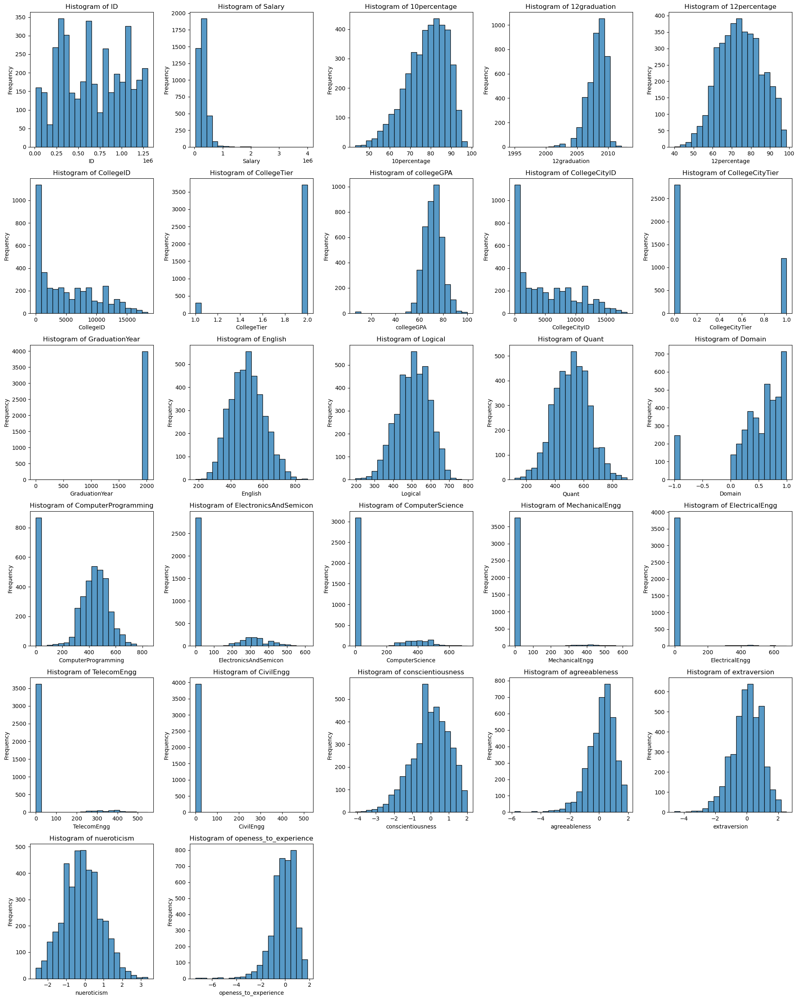

In [10]:
plt.figure(figsize=(20, 25))

for i, col in enumerate(inttype.columns, 1):
    
    plt.subplot(len(inttype.columns) // 5 + 1, 5, i)
    
    sns.histplot(inttype[col], bins=20, kde=False)
    
    plt.title(f'Histogram of {col}')

    plt.xlabel(col)

    plt.ylabel('Frequency')

plt.tight_layout()

plt.show()

## Boxplot

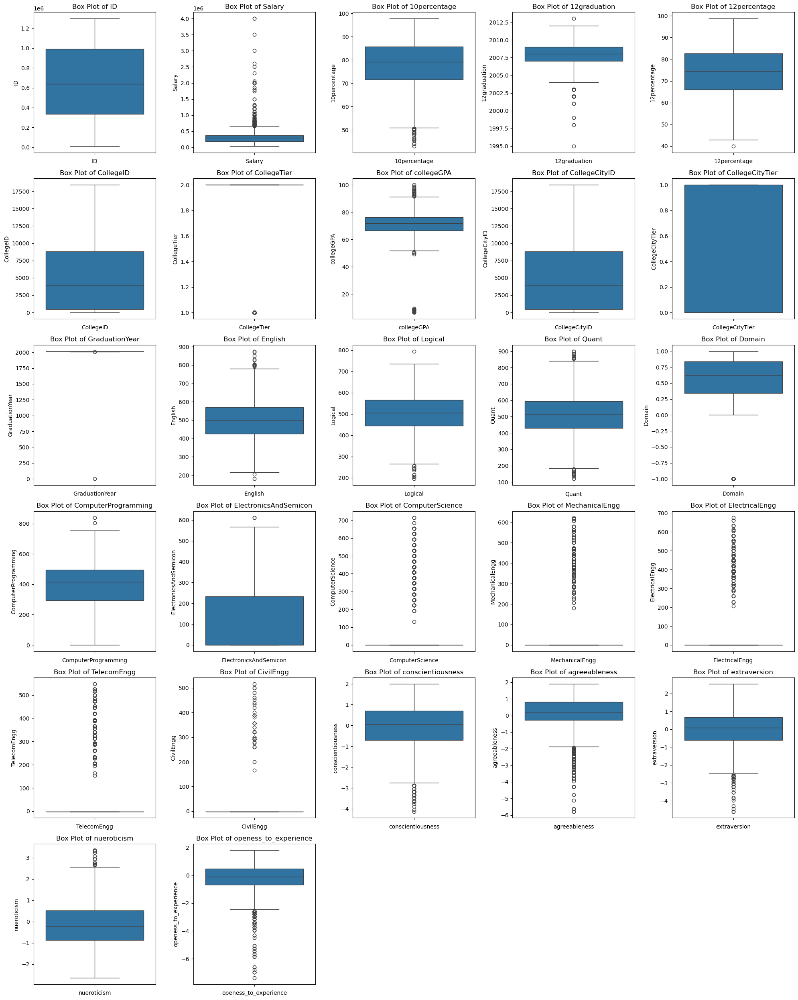

In [11]:
plt.figure(figsize=(20, 25))

for i, col in enumerate(inttype.columns, 1):
    
    plt.subplot(len(inttype.columns) // 5 + 1, 5, i)
    
    sns.boxplot(y=inttype[col])
    
    plt.title(f'Box Plot of {col}')

    plt.xlabel(col)

plt.tight_layout()

plt.show()

## Countplots

C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\3975604051.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=counts.index, y=counts.values, palette='Set2')
C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\3975604051.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=counts.index, y=counts.values, palette='Set2')
C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\3975604051.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=counts.index, y=counts.values, palette='Set2')
C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\3975604051.py:8

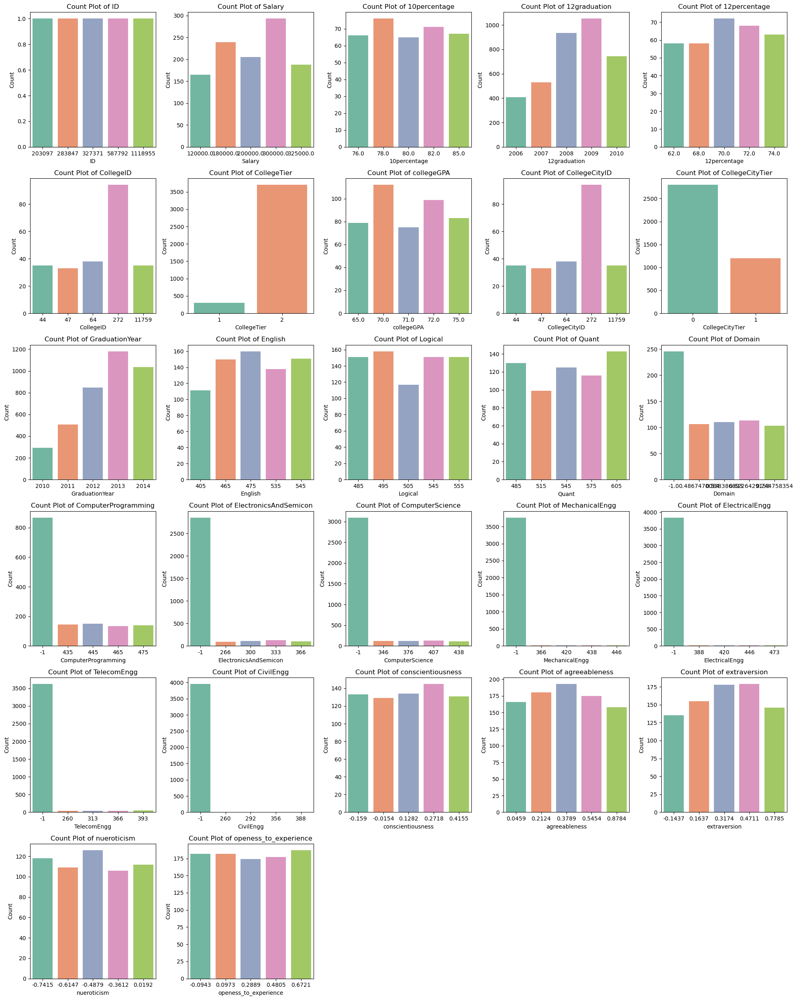

In [12]:
plt.figure(figsize=(20, 25))
for i, col in enumerate(inttype.columns, 1):
    
    plt.subplot(len(inttype.columns) // 5 + 1, 5, i)
    
    counts = inttype[col].value_counts().nlargest(5)
    
    sns.barplot(x=counts.index, y=counts.values, palette='Set2')
    
    plt.title(f'Count Plot of {col}')

    plt.xlabel(col)

    plt.ylabel('Count')

plt.tight_layout()

plt.show()

## Outliers

In [13]:
outliers = {}

for col in inttype.columns:
    Q1 = inttype[col].quantile(0.25)
    Q3 = inttype[col].quantile(0.75)
    
    IQR = Q3 - Q1
    
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    outlier_mask = (inttype[col] < lower_bound) | (inttype[col] > upper_bound)
    
    outlier_values = inttype[col][outlier_mask]
    if not outlier_values.empty:
        outliers[col] = outlier_values

if outliers:
    for col, outlier_values in outliers.items():

        print(f'Outliers in {col}:')

        print(outlier_values.tolist())

        print('\n')

Outliers in Salary:
[1100000.0, 800000.0, 1500000.0, 1200000.0, 675000.0, 1860000.0, 660000.0, 700000.0, 785000.0, 700000.0, 690000.0, 700000.0, 1110000.0, 1200000.0, 1000000.0, 715000.0, 820000.0, 720000.0, 2600000.0, 715000.0, 800000.0, 1025000.0, 775000.0, 1300000.0, 3500000.0, 910000.0, 730000.0, 680000.0, 1300000.0, 1050000.0, 2000000.0, 700000.0, 860000.0, 800000.0, 800000.0, 690000.0, 4000000.0, 2020000.0, 700000.0, 700000.0, 760000.0, 800000.0, 870000.0, 2050000.0, 700000.0, 1320000.0, 755000.0, 880000.0, 3000000.0, 700000.0, 720000.0, 820000.0, 2500000.0, 2300000.0, 950000.0, 1300000.0, 1200000.0, 4000000.0, 700000.0, 700000.0, 1800000.0, 725000.0, 1200000.0, 720000.0, 700000.0, 930000.0, 680000.0, 1000000.0, 750000.0, 1000000.0, 705000.0, 1745000.0, 2000000.0, 1800000.0, 850000.0, 845000.0, 700000.0, 660000.0, 820000.0, 750000.0, 1200000.0, 670000.0, 1030000.0, 770000.0, 800000.0, 720000.0, 900000.0, 1210000.0, 1500000.0, 1100000.0, 680000.0, 675000.0, 700000.0, 800000.0, 700

## Frequency distribution

In [14]:

categorical_cols = data.select_dtypes(include='object')

Frequency distribution for Unnamed: 0:
Unnamed: 0
train    3998
Name: count, dtype: int64


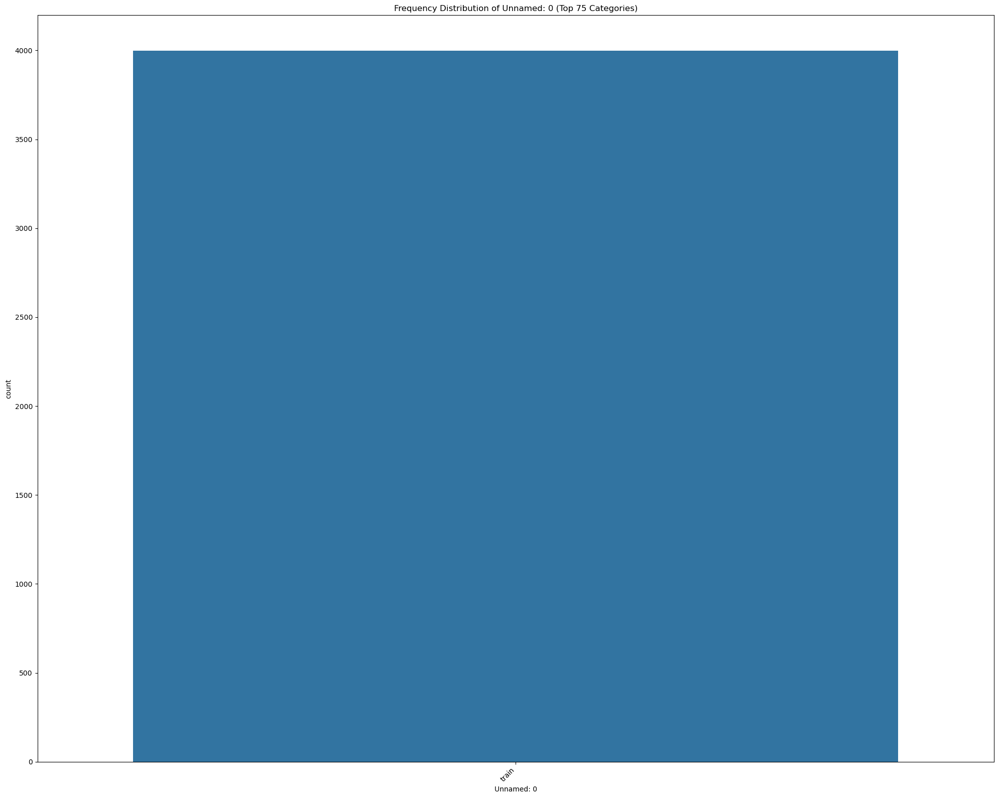

Observations for Unnamed: 0:
The column Unnamed: 0 has only one unique value, indicating it might not provide useful information for analysis.


Frequency distribution for DOJ:
DOJ
7/1/14 0:00     199
6/1/14 0:00     180
8/1/14 0:00     178
9/1/14 0:00     142
1/1/14 0:00     142
               ... 
6/1/07 0:00       1
6/1/91 0:00       1
9/1/07 0:00       1
12/1/15 0:00      1
11/1/08 0:00      1
Name: count, Length: 75, dtype: int64


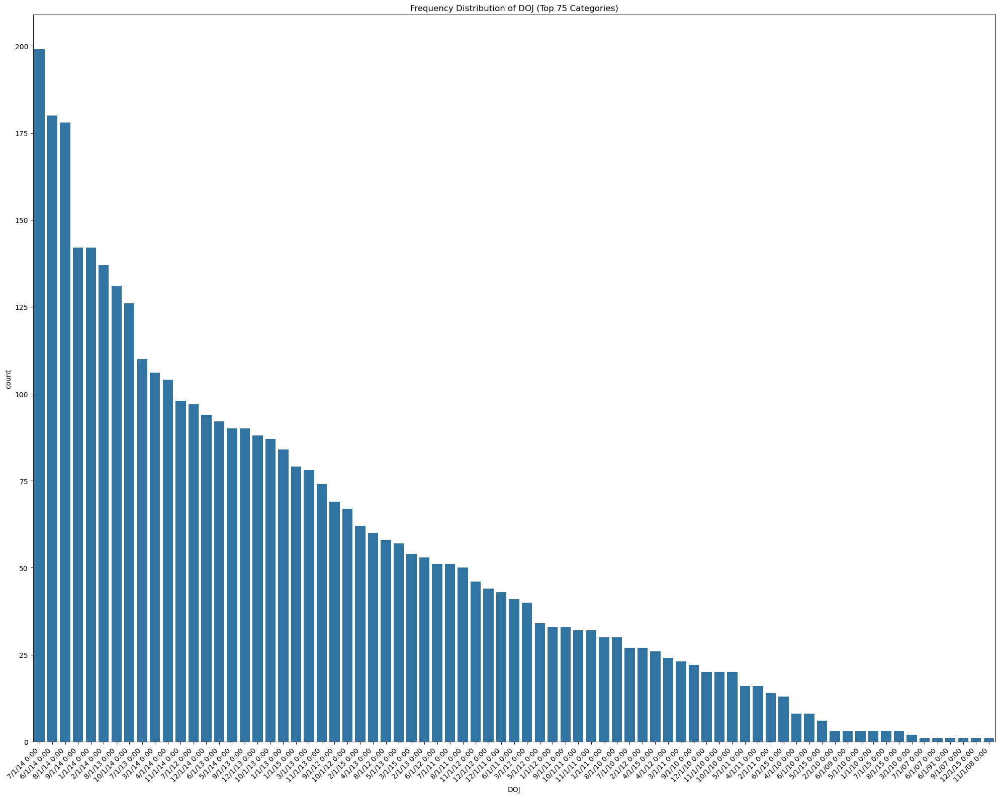

Observations for DOJ:
The column DOJ has 75 unique categories.
The most frequent category in DOJ is: 7/1/14 0:00 with 199 occurrences.


Frequency distribution for DOL:
DOL
present         1875
4/1/15 0:00      573
3/1/15 0:00      124
5/1/15 0:00      112
1/1/15 0:00       99
                ... 
3/1/05 0:00        1
10/1/15 0:00       1
2/1/10 0:00        1
2/1/11 0:00        1
10/1/10 0:00       1
Name: count, Length: 67, dtype: int64


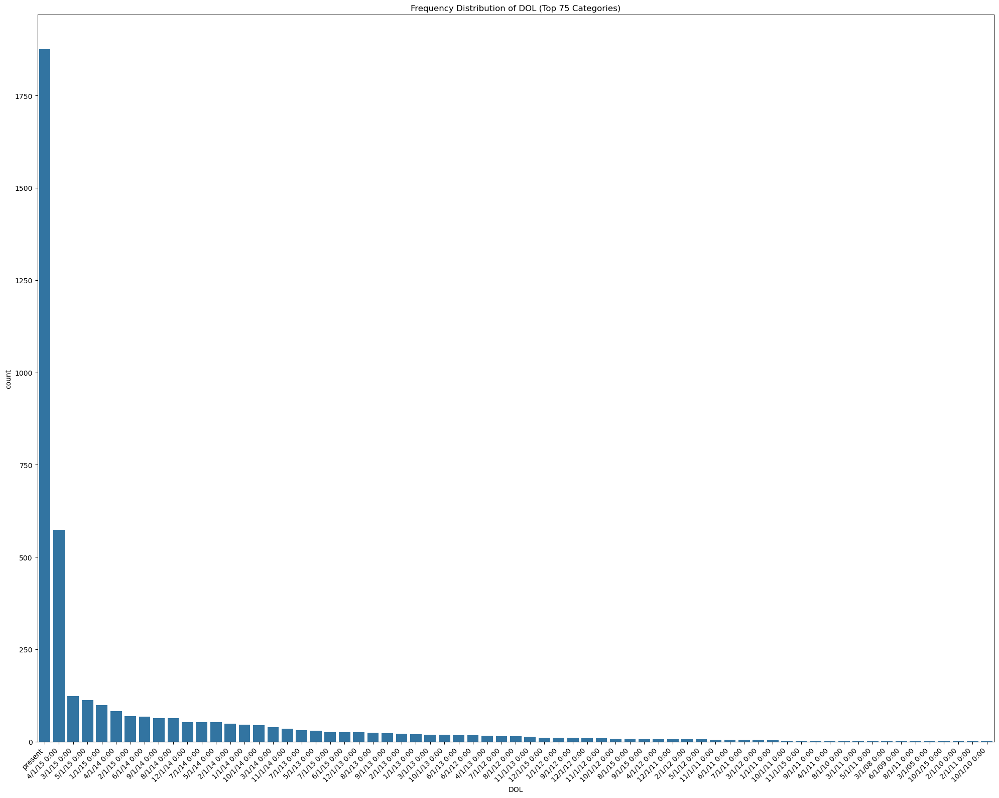

Observations for DOL:
The column DOL has 67 unique categories.
The most frequent category in DOL is: present with 1875 occurrences.


Frequency distribution for Designation:
Designation
software engineer              539
software developer             265
system engineer                205
programmer analyst             139
systems engineer               118
                              ... 
junior software engineer         9
electrical project engineer      9
business analyst consultant      9
telecom engineer                 9
web designer                     9
Name: count, Length: 75, dtype: int64


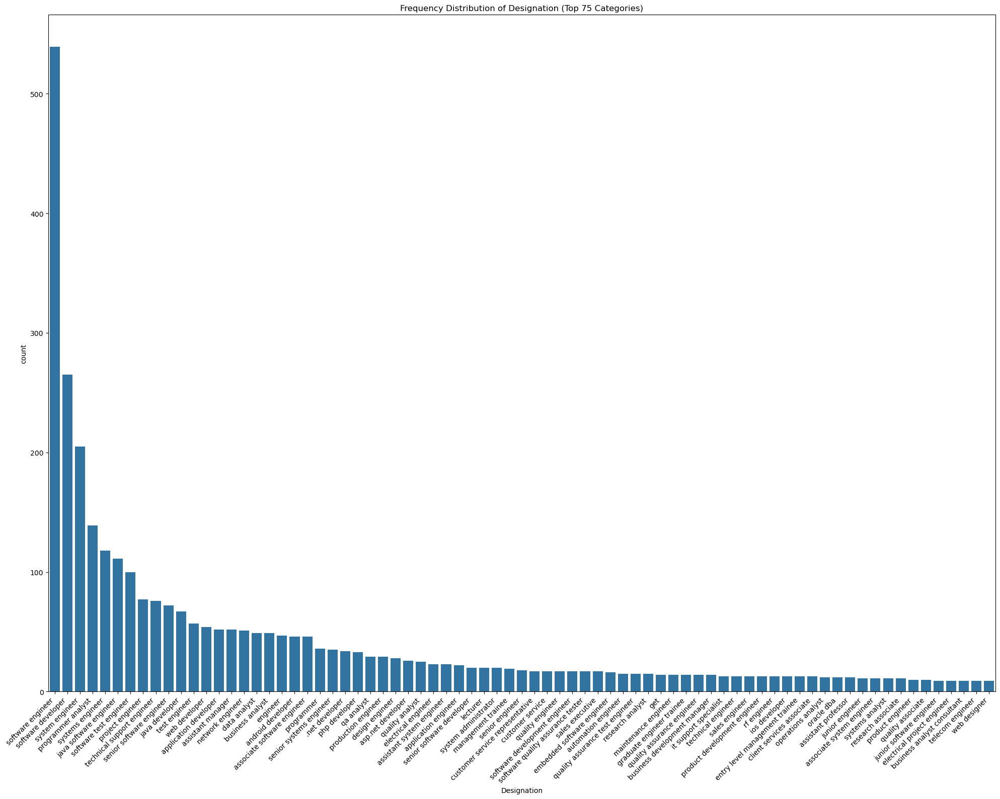

Observations for Designation:
The column Designation has 75 unique categories.
The most frequent category in Designation is: software engineer with 539 occurrences.


Frequency distribution for JobCity:
JobCity
Bangalore      627
-1             461
Noida          368
Hyderabad      335
Pune           290
              ... 
bengaluru        3
Nashik           3
Aurangabad       3
Ludhiana         3
bhubaneswar      3
Name: count, Length: 75, dtype: int64


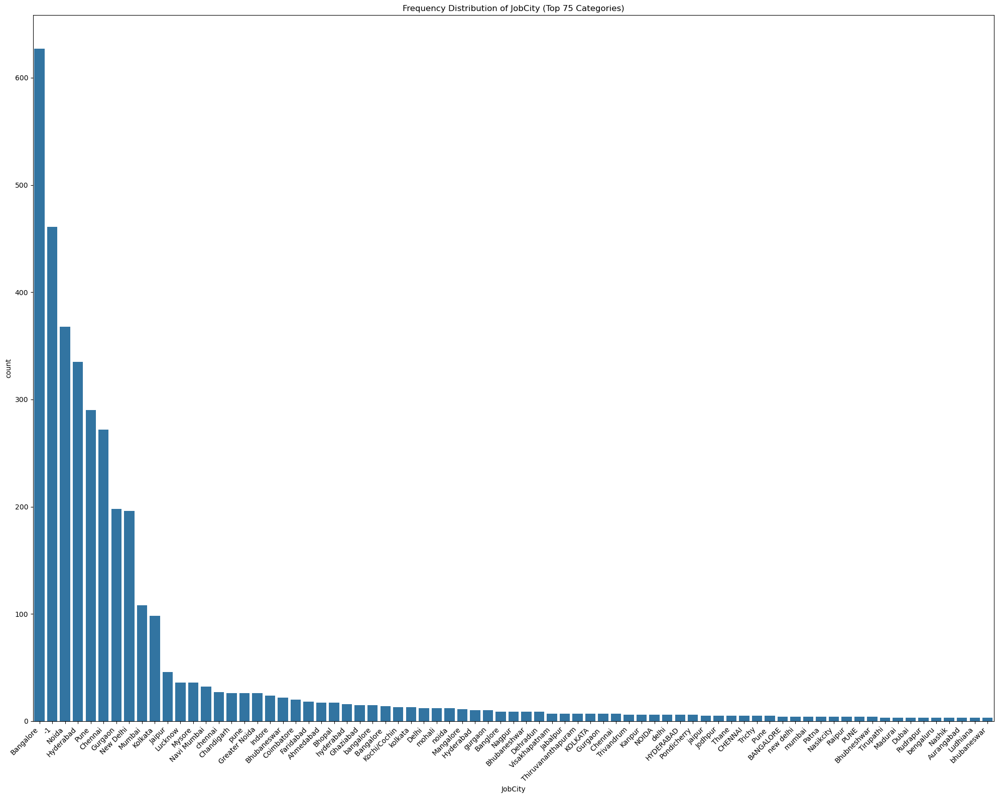

Observations for JobCity:
The column JobCity has 75 unique categories.
The most frequent category in JobCity is: Bangalore with 627 occurrences.


Frequency distribution for Gender:
Gender
m    3041
f     957
Name: count, dtype: int64


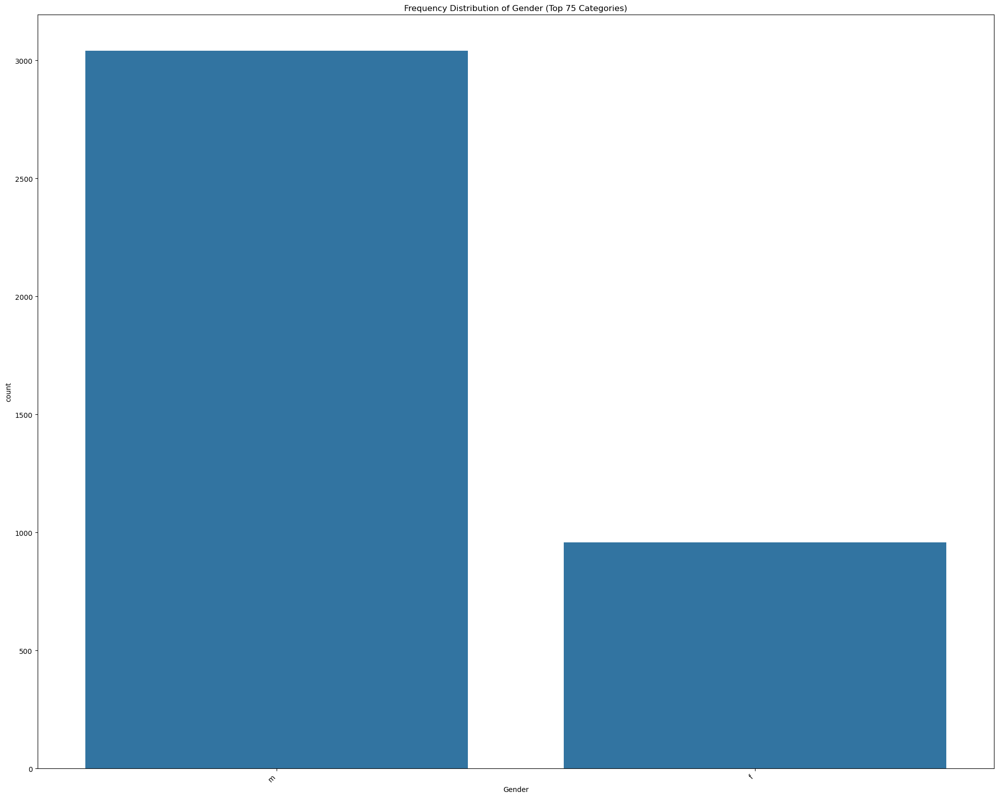

Observations for Gender:
The column Gender has 2 unique categories.
The most frequent category in Gender is: m with 3041 occurrences.


Frequency distribution for DOB:
DOB
1/1/91 0:00      11
7/15/91 0:00     10
7/5/91 0:00       8
12/13/91 0:00     8
6/3/91 0:00       8
                 ..
7/26/91 0:00      5
6/4/91 0:00       5
6/2/92 0:00       5
6/16/90 0:00      5
7/28/91 0:00      5
Name: count, Length: 75, dtype: int64


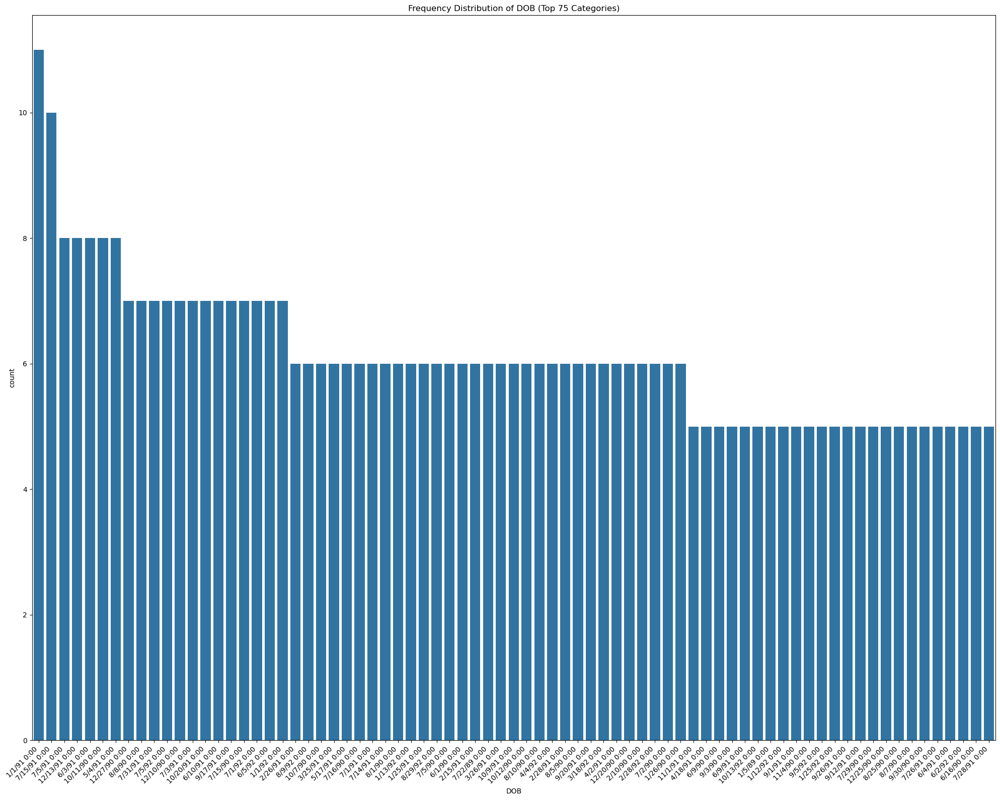

Observations for DOB:
The column DOB has 75 unique categories.
The most frequent category in DOB is: 1/1/91 0:00 with 11 occurrences.


Frequency distribution for 10board:
10board
cbse               1395
state board        1164
0                   350
icse                281
ssc                 122
                   ... 
jkbose                2
pune                  2
karnataka board       2
cbsc                  1
kolhapur              1
Name: count, Length: 75, dtype: int64


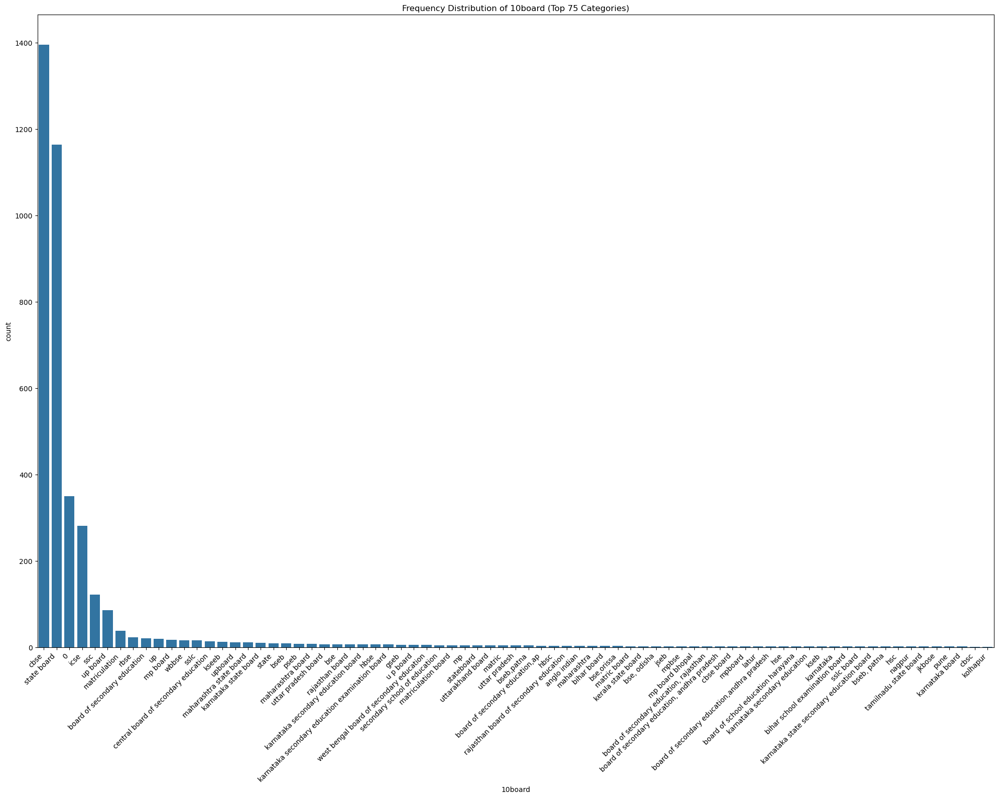

Observations for 10board:
The column 10board has 75 unique categories.
The most frequent category in 10board is: cbse with 1395 occurrences.


Frequency distribution for 12board:
12board
cbse                     1400
state board              1254
0                         359
icse                      129
up board                   87
                         ... 
gsheb                       2
pre university board        2
wbbhse                      2
ibe                         2
tamilnadu state board       2
Name: count, Length: 75, dtype: int64


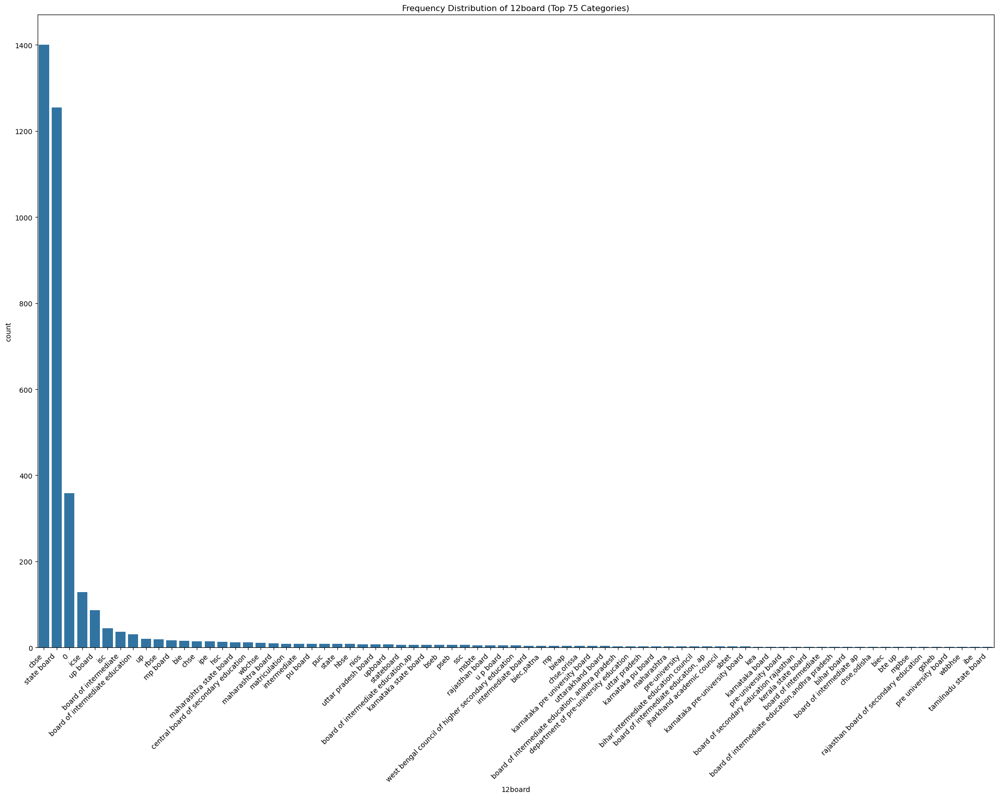

Observations for 12board:
The column 12board has 75 unique categories.
The most frequent category in 12board is: cbse with 1400 occurrences.


Frequency distribution for Degree:
Degree
B.Tech/B.E.      3700
MCA               243
M.Tech./M.E.       53
M.Sc. (Tech.)       2
Name: count, dtype: int64


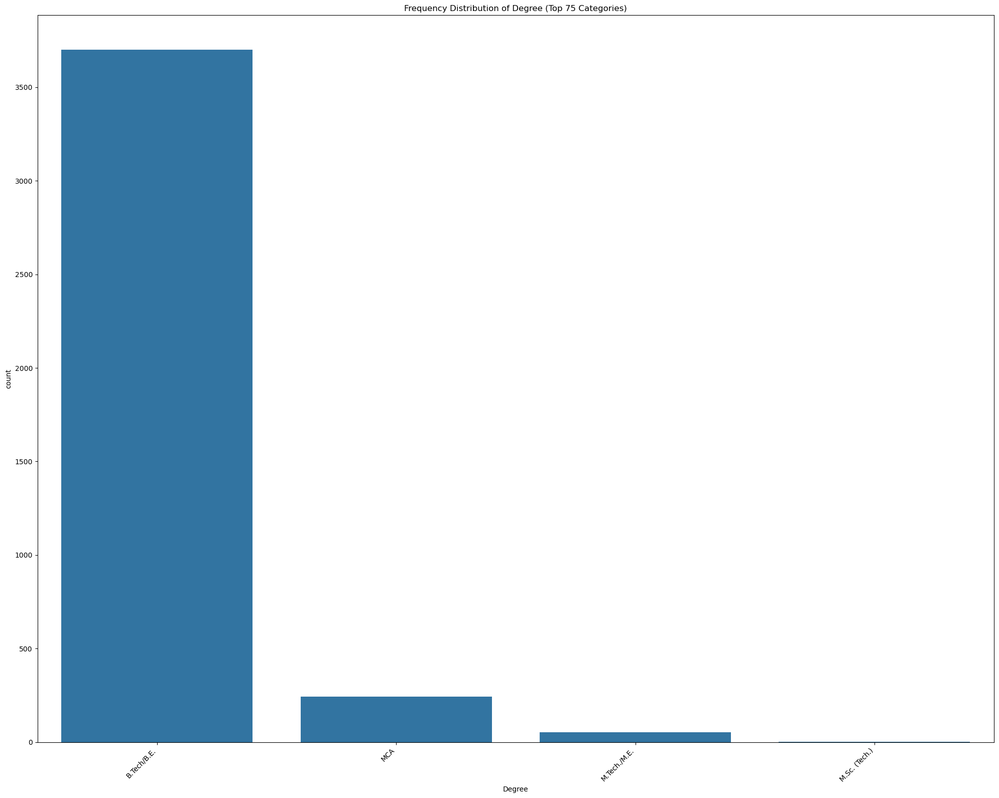

Observations for Degree:
The column Degree has 4 unique categories.
The most frequent category in Degree is: B.Tech/B.E. with 3700 occurrences.


Frequency distribution for Specialization:
Specialization
electronics and communication engineering      880
computer science & engineering                 744
information technology                         660
computer engineering                           600
computer application                           244
mechanical engineering                         201
electronics and electrical engineering         196
electronics & telecommunications               121
electrical engineering                          82
electronics & instrumentation eng               32
civil engineering                               29
electronics and instrumentation engineering     27
information science engineering                 27
instrumentation and control engineering         20
electronics engineering                         19
biotechnology                  

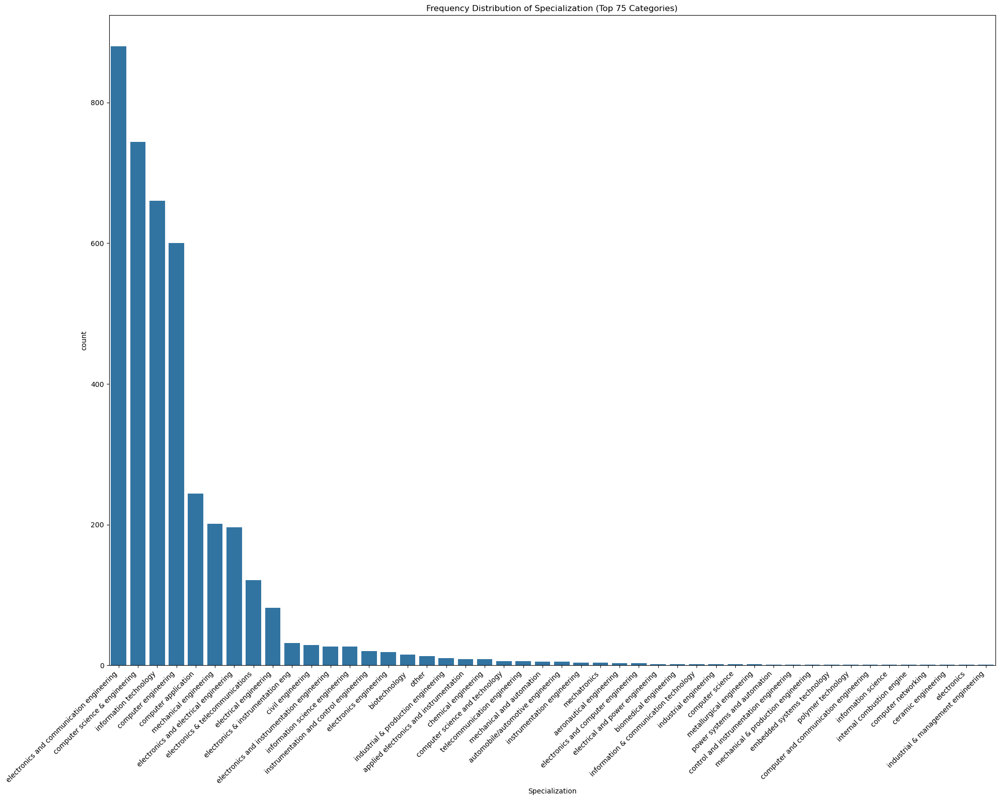

Observations for Specialization:
The column Specialization has 46 unique categories.
The most frequent category in Specialization is: electronics and communication engineering with 880 occurrences.


Frequency distribution for CollegeState:
CollegeState
Uttar Pradesh        915
Karnataka            370
Tamil Nadu           367
Telangana            319
Maharashtra          262
Andhra Pradesh       225
West Bengal          196
Punjab               193
Madhya Pradesh       189
Haryana              180
Rajasthan            174
Orissa               172
Delhi                162
Uttarakhand          113
Kerala                33
Jharkhand             28
Chhattisgarh          27
Gujarat               24
Himachal Pradesh      16
Bihar                 10
Jammu and Kashmir      7
Assam                  5
Union Territory        5
Sikkim                 3
Meghalaya              2
Goa                    1
Name: count, dtype: int64


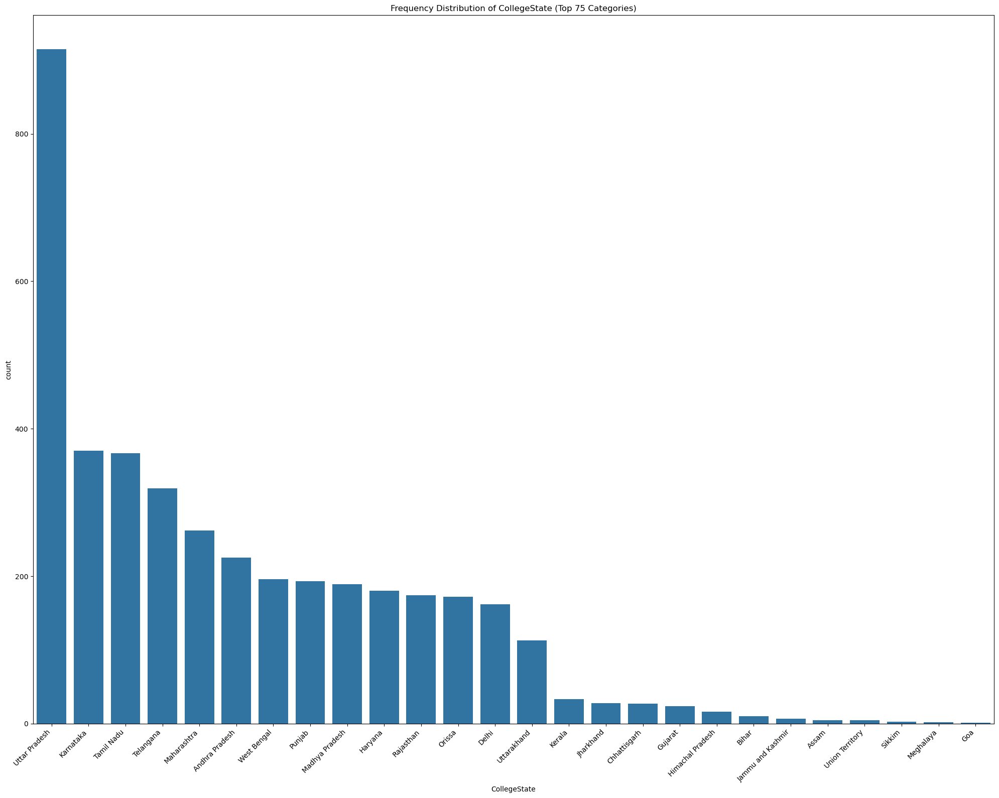

Observations for CollegeState:
The column CollegeState has 26 unique categories.
The most frequent category in CollegeState is: Uttar Pradesh with 915 occurrences.




In [15]:
for col in categorical_cols.columns:

    print(f'Frequency distribution for {col}:')
    
    frequency_distribution = data[col].value_counts().head(75)

    print(frequency_distribution)
    
    plt.figure(figsize=(20, 16))

    sns.countplot(data=data, x=col, order=frequency_distribution.index)

    plt.title(f'Frequency Distribution of {col} (Top 75 Categories)')

    plt.xticks(rotation=45, ha='right')

    plt.tight_layout()

    plt.show()
    
    print(f'Observations for {col}:')

    if len(frequency_distribution) == 1:

        print(f"The column {col} has only one unique value, indicating it might not provide useful information for analysis.")

    elif len(frequency_distribution) > 75:

        print(f"The column {col} has more than 75 unique categories, displaying only the top 75.")

        print(f"The most frequent category in {col} is: {frequency_distribution.idxmax()} with {frequency_distribution.max()} occurrences.")

    else:

        print(f"The column {col} has {len(frequency_distribution)} unique categories.")

        print(f"The most frequent category in {col} is: {frequency_distribution.idxmax()} with {frequency_distribution.max()} occurrences.")

    print('\n')

In [16]:
data.dtypes

Unnamed: 0                object
ID                         int64
Salary                   float64
DOJ                       object
DOL                       object
Designation               object
JobCity                   object
Gender                    object
DOB                       object
10percentage             float64
10board                   object
12graduation               int64
12percentage             float64
12board                   object
CollegeID                  int64
CollegeTier                int64
Degree                    object
Specialization            object
collegeGPA               float64
CollegeCityID              int64
CollegeCityTier            int64
CollegeState              object
GraduationYear             int64
English                    int64
Logical                    int64
Quant                      int64
Domain                   float64
ComputerProgramming        int64
ElectronicsAndSemicon      int64
ComputerScience            int64
Mechanical

# Bivariate Analysis

In [17]:
inttype.head()

,ID,Salary,10percentage,12graduation,12percentage,CollegeID,CollegeTier,collegeGPA,CollegeCityID,CollegeCityTier,...,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,203097,420000.0,84.3,2007,95.8,1141,2,78.00,1141,0,...,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,579905,500000.0,85.4,2007,85.0,5807,2,70.06,5807,0,...,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,810601,325000.0,85.0,2010,68.2,64,2,70.00,64,0,...,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,267447,1100000.0,85.6,2007,83.6,6920,1,74.64,6920,1,...,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,343523,200000.0,78.0,2008,76.8,11368,2,73.90,11368,0,...,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [18]:
inttype = data.select_dtypes(include=['int64', 'float64'])

## Scatter plot

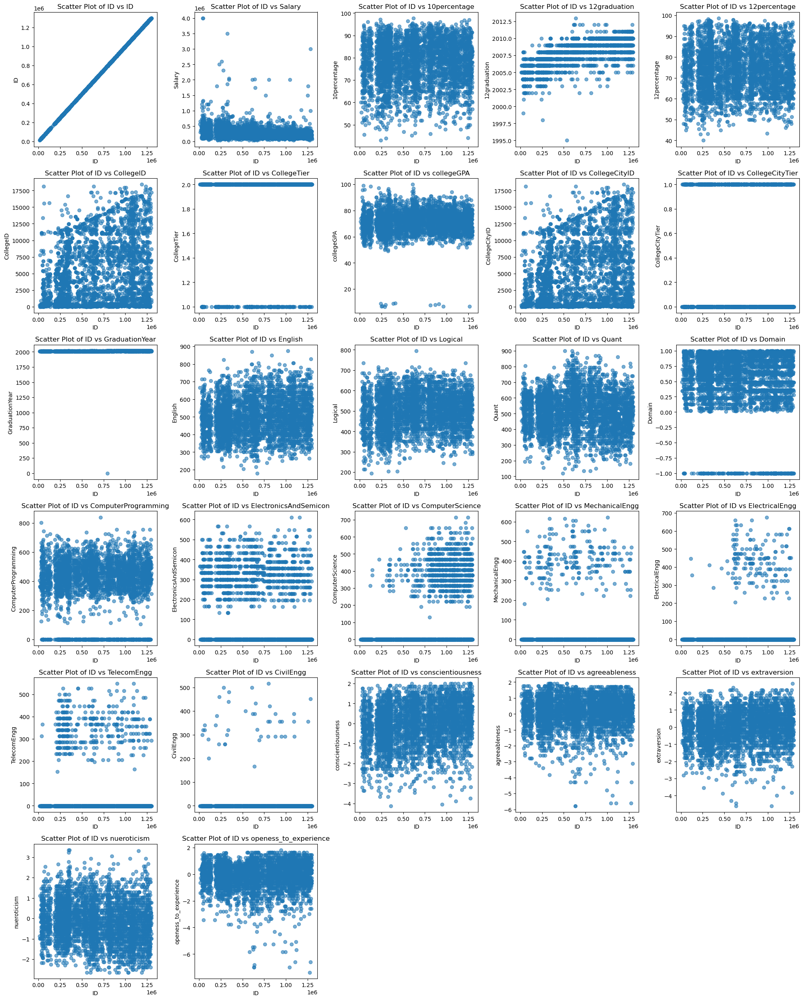

In [19]:
plt.figure(figsize=(20, 25))

for i, col in enumerate(inttype.columns, 1):

    plt.subplot(len(inttype.columns) // 5 + 1, 5, i)
    
    plt.scatter(inttype['ID'], inttype[col], alpha=0.6)
    
    plt.title(f'Scatter Plot of ID vs {col}')

    plt.xlabel('ID')

    plt.ylabel(col)

plt.tight_layout()

plt.show()

## Hexbin plot

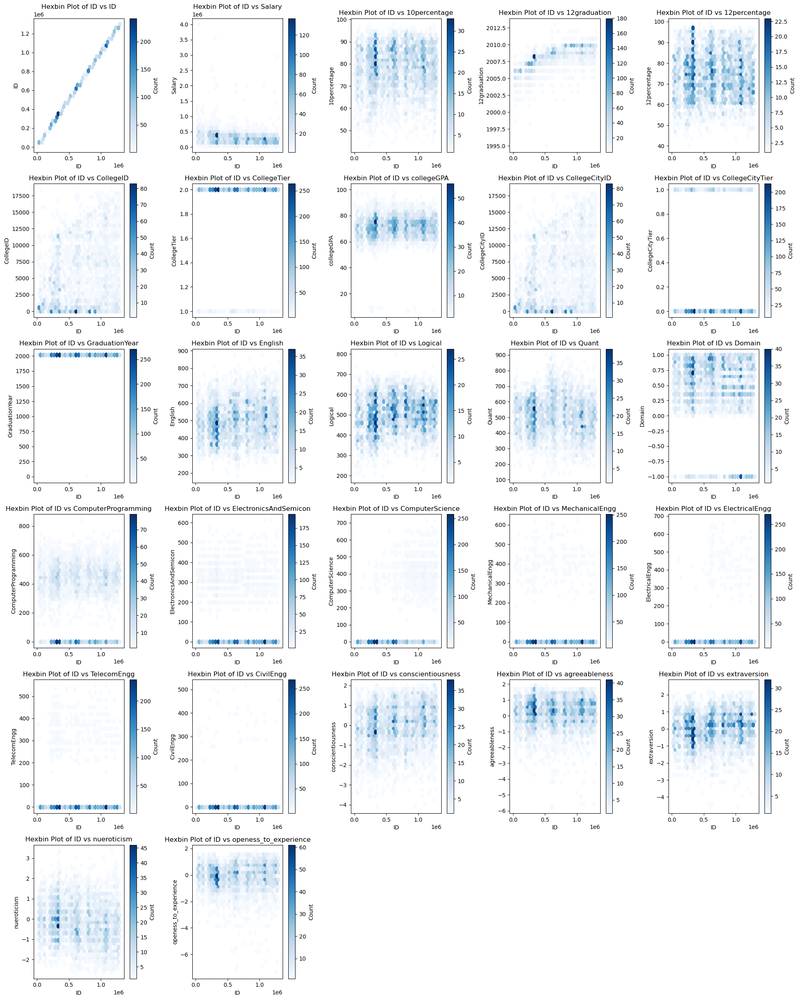

In [20]:
plt.figure(figsize=(20, 25))

for i, col in enumerate(inttype.columns, 1):

    plt.subplot(len(inttype.columns) // 5 + 1, 5, i)
    
    plt.hexbin(inttype['ID'], inttype[col], gridsize=30, cmap='Blues', mincnt=1)

    plt.colorbar(label='Count')
    
    plt.title(f'Hexbin Plot of ID vs {col}')

    plt.xlabel('ID')

    plt.ylabel(col)

plt.tight_layout()

plt.show()

## Pair plot

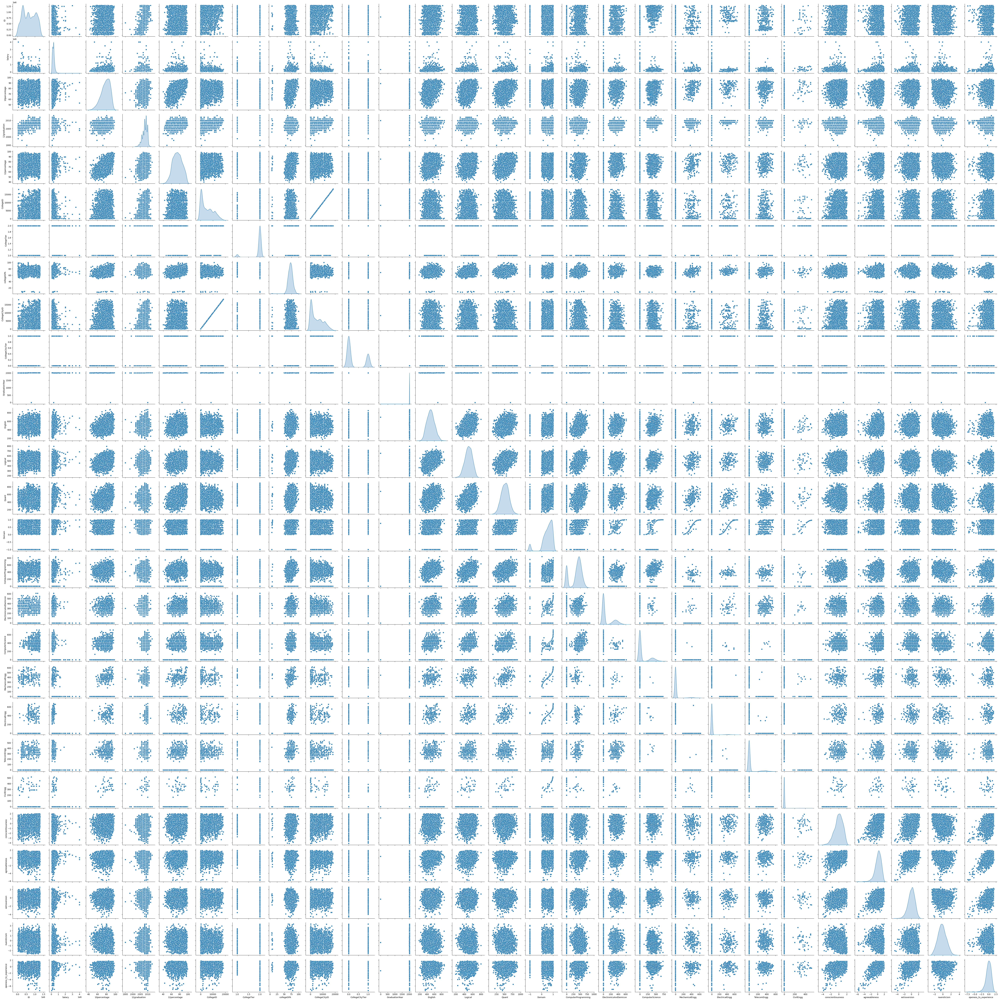

In [21]:
sns.pairplot(inttype, vars=inttype.columns, diag_kind='kde')

plt.show()

## Box plot

C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\651270856.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=categorical_column, y=col, data=dataset, palette='Set2')
C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\651270856.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=categorical_column, y=col, data=dataset, palette='Set2')
C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\651270856.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=categorical_column, y=col, data=dataset, palette='Set2')
C:\Users\adhik\AppData\Local\Temp\ipy

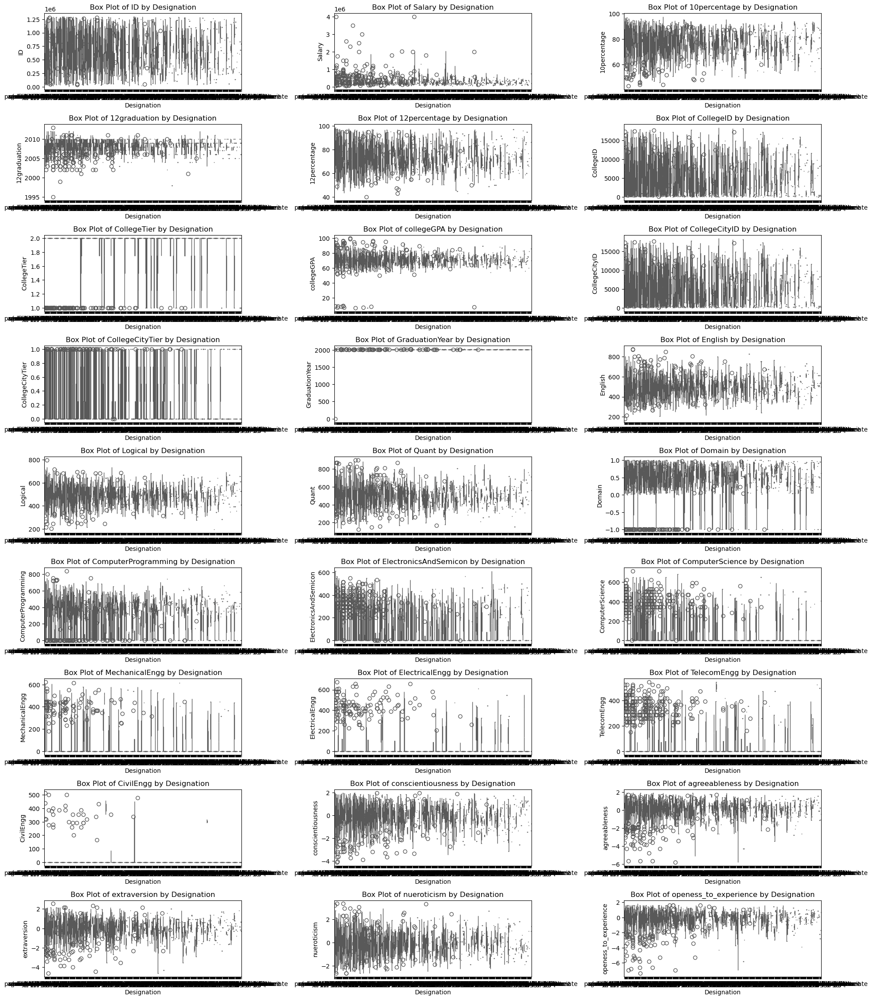

In [50]:
categorical_column= 'Designation'

plt.figure(figsize=(20,25))

for i, col in enumerate(inttype.columns, 1):

    plt.subplot(len(inttype.columns) // 3 + 1, 3, i)

    sns.boxplot(x=categorical_column, y=col, data=dataset, palette='Set2')

    plt.title(f'Box Plot of {col} by {categorical_column}')

    plt.xlabel(categorical_column)

    plt.ylabel(col)

plt.tight_layout()

plt.show()

## Bar plot

C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\3406174872.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=mean_values.index, y=mean_values.values, palette='Set2')
C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\3406174872.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=mean_values.index, y=mean_values.values, palette='Set2')
C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\3406174872.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=mean_values.index, y=mean_values.values, palette='Set2')
C:\Users\adhik\AppData\Local\Temp\

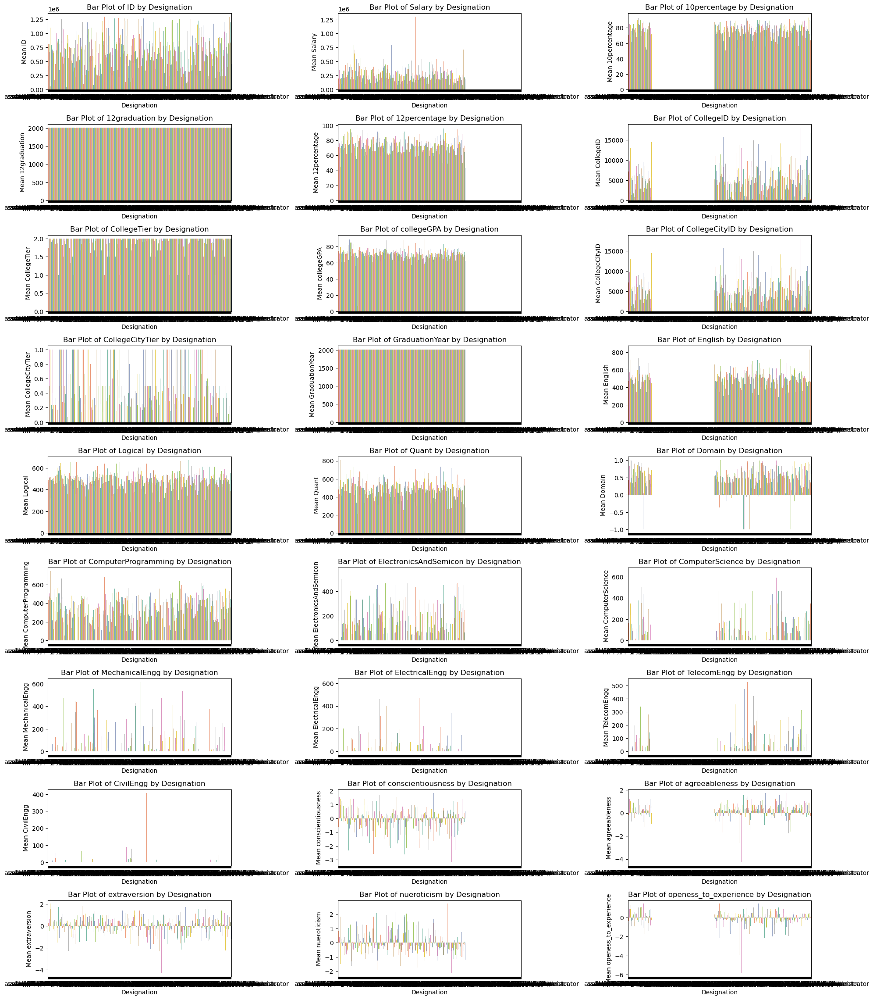

In [23]:
plt.figure(figsize=(20, 25))

for i, col in enumerate(inttype.columns, 1):

    plt.subplot(len(inttype.columns) // 3 + 1, 3, i)

    mean_values = dataset.groupby(categorical_column)[col].mean()
    
    sns.barplot(x=mean_values.index, y=mean_values.values, palette='Set2')

    plt.title(f'Bar Plot of {col} by {categorical_column}')

    plt.xlabel(categorical_column)

    plt.ylabel(f'Mean {col}')

plt.tight_layout()

plt.show()

## Stack plot

C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\2043611726.py:16: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


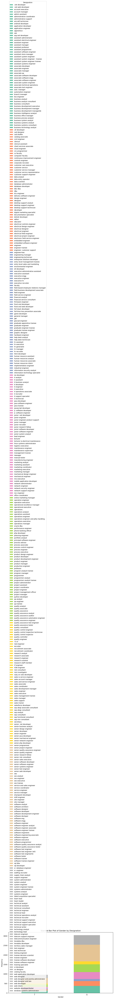

In [49]:
categorical_col1 = 'Gender'
categorical_col2 = 'Designation'

crosstab = pd.crosstab(dataset[categorical_col1], dataset[categorical_col2])

crosstab.plot(kind='bar', stacked=True, figsize=(12, 7), colormap='Set2')

plt.title(f'Stacked Bar Plot of {categorical_col1} by {categorical_col2}')

plt.xlabel(categorical_col1)

plt.ylabel('Frequency')

plt.xticks(rotation=False)

plt.tight_layout()

plt.show()


# Research Question

Unique Designations in the dataset:
['senior quality engineer' 'assistant manager' 'systems engineer'
 'senior software engineer' 'get' 'system engineer'
 'java software engineer' 'mechanical engineer' 'electrical engineer'
 'project engineer' 'senior php developer' 'senior systems engineer'
 'quality assurance engineer' 'qa analyst' 'network engineer'
 'product development engineer' 'associate software developer'
 'data entry operator' 'software engineer' 'developer'
 'electrical project engineer' 'programmer analyst' 'systems analyst'
 'ase' 'telecommunication engineer' 'application developer'
 'ios developer' 'executive assistant' 'online marketing manager'
 'documentation specialist' 'associate software engineer'
 'management trainee' 'site manager' 'software developer' '.net developer'
 'production engineer' 'jr. software engineer'
 'trainee software developer' 'ui developer' 'assistant system engineer'
 'android developer' 'customer service' 'test engineer' 'java developer'
 'eng

C:\Users\adhik\AppData\Local\Temp\ipykernel_5960\1349264758.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Designation', y='Salary', data=filtered_data, palette='Set2')


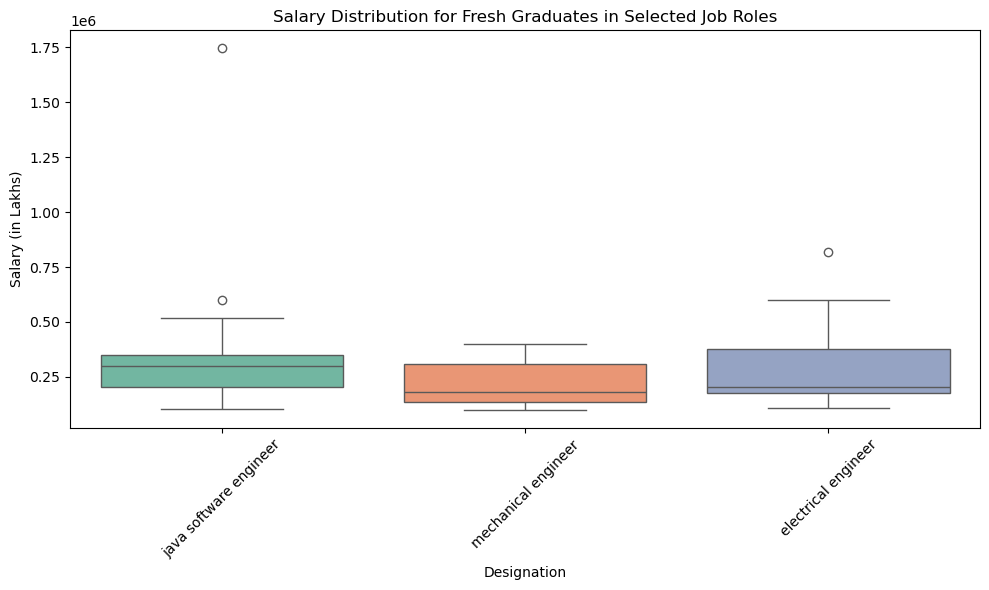

In [36]:
print("Unique Designations in the dataset:")

print(data['Designation'].unique())

roles_of_interest = ['java software engineer', 'mechanical engineer', 'electrical engineer']

filtered_data = data[data['Designation'].isin(roles_of_interest)]

if filtered_data.empty:

    print("No data found for the specified roles.")

else:
    mean_salary = filtered_data['Salary'].mean()

    median_salary = filtered_data['Salary'].median()

    print(f"Mean Salary for specified roles: {mean_salary:.2f} lakhs")

    print(f"Median Salary for specified roles: {median_salary:.2f} lakhs")

    plt.figure(figsize=(10, 6))

    sns.boxplot(x='Designation', y='Salary', data=filtered_data, palette='Set2')

    plt.title('Salary Distribution for Fresh Graduates in Selected Job Roles')

    plt.xlabel('Designation')

    plt.ylabel('Salary (in Lakhs)')

    plt.xticks(rotation=45)

    plt.tight_layout()
    
    plt.show()